In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/README.dataset.txt
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/README.roboflow.txt
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/data.yaml
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_image.jpg
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid/labels/12_mp4-10_jpg.rf.4bb699a2ec90e19cb4680ee239ae579c.txt
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid/labels/6_mp4-31_jpg.rf.c786274ab129629ca618e454b4146f11.txt
/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid/labels/6_mp4-29_jpg.rf.e73ca25e92e590b325006f010ad4e319.txt
/kaggle/input/top-view

In [2]:
!pip install Ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 17.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 32.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 85.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.8.93
    Uninstalling nvidia-nvjitlink-cu12-12.8.93:
      Successfully uninstalled nvidia-nvjitlink-cu12-12.8.93
  Attempting uninstall: nvidia-curand-cu12
    Found existing installation: nvidia-curand-cu12 10.3.9.90
    Uninstalling nvidia-curand-cu12-10.3.9

# Import Required Libraries

In [3]:
from ultralytics import YOLO
import pandas as pd
import numpy as np
import os
from collections import Counter
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from collections import defaultdict
import random
from IPython.display import Video , YouTubeVideo
import torch
import yaml
import time
import subprocess
import warnings
warnings.filterwarnings('ignore')
plt.style.use('dark_background')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
print('Currently using GPU' if torch.cuda.is_available() else 'Currently using CPU')

Currently using GPU


# Load the Dataset

In [5]:
File_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset'
Train_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train'
Valid_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid'
Image_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_image.jpg'
Video_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4'

## All car Samples

* Now, want to count all car samples in all images. Can count the number of all cars by making two loops in .txt files. As it has shown there are 5615 samples in 536 train images.

In [6]:
def count_class_ids_in_yolo_files(directory_path):
    class_id_counts = Counter()
    for filename in os.listdir(directory_path):
        if filename.endswith('.txt'):
            file_path = os.path.join(directory_path, filename)
            with open(file_path, 'r') as file:
                for line in file:
                    class_id = line.split()[0]
                    class_id_counts[class_id] += 1
    return class_id_counts
directory_path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/labels'
class_id_counts = count_class_ids_in_yolo_files(directory_path)

for class_id, count in class_id_counts.items():
    print(f"Class ID {class_id} (vehicle): {count} samples")
                    

Class ID 0 (vehicle): 5615 samples


# Loading Yolov11 model

## YOLOv11 COCO

* There are 5 different kinds of YOLOv11, each tailored to different needs. Each model variant has varying parameters, FLOPs, APval, and latency. YOLOv11-nano has the fewest parameters, while YOLOv11-extra large is the most powerful. It is important to note that all these models are trained and evaluated on tge COCO dataset.
* **Test Size:** The standard image size for all 5 variants is 640*640, consistent with previous YOLO vaersions like YOLOv10, YOLOv9, and others.
* **Params:** Params refer to the size and complexity of the model. A higher number of parameters generally leads to better accuracy but may result in heavier perocessing requirements.
* **FLOP:** FLOP measures the computational expense of a model. A lower FLOP indicates a more efficient model that is easier for systems to handle.
* **APval:** APval measures the model's effectiveness in detecting objects within the validation dataset.
* **Latency:** Latency represents how quickly the model processes data. this is an essential metric, especially for real-time applications.
* **Conclusion:** These parameters provide insights into Seed, Accuracy, and Computational Efficiency for each YOLOv11 model. Depending on the specific needs of a project, you can select the best model varient. I selected the yolov11l.pt model for my project.

In [7]:
model = YOLO("yolo11l.pt")

100%|██████████| 49.0M/49.0M [00:00<00:00, 228MB/s]


In [8]:
def Show_Predicted_Images(model , source , imgsz , conf , title , figsize):
    prediction = model.predict(source=source , imgsz = imgsz , conf = conf)
    img = prediction[0].plot(line_width = 2)
    img = cv2.cvtColor(img , cv2.COLOR_BGR2RGB)
    plt.figure(figsize=figsize)
    plt.imshow(img)
    plt.title(title, fontsize=20)
    plt.axis('off')
    plt.show()

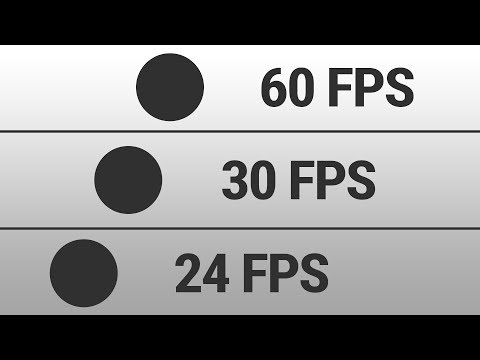

In [9]:
YouTubeVideo(id='_SzGQkI-IwM' , width=1000 , height=400)

In [10]:
Train_images = []
Valid_images = []
Train_images_mode = []
Valid_images_mode = []
for img in os.listdir(Train_Data_Path+'/images'):
            Train_images.append( os.path.join(Train_Data_Path+'/images',img))
            Train_images_mode.append(img.split('.')[3])
for img in os.listdir(Valid_Data_Path+'/images'):
            Valid_images.append(os.path.join(Valid_Data_Path+'/images',img))
            Valid_images_mode.append(img.split('.')[3])

In [11]:
print(f'The number of Train images : {len(Train_images)}')
print(f'The number of valid images : {len(Valid_images)}')
print('--'* 20 )
print(f'The Mode of all Train images : {pd.Series(Train_images_mode).value_counts()}')
print('--'* 20 )
print(f'The Mode of all Valid images : {pd.Series(Valid_images_mode).value_counts()}')

The number of Train images : 536
The number of valid images : 90
----------------------------------------
The Mode of all Train images : jpg    536
Name: count, dtype: int64
----------------------------------------
The Mode of all Valid images : jpg    90
Name: count, dtype: int64


In [12]:
def show_images_train(path , num , seed=42 , title=None):
    plt.style.use('dark_background')
    random.seed(seed)
    number_image = random.choices( path,k=num)
    plt.figure(figsize=(15 , 12))
    plt.suptitle(title , fontsize=15 )
    for i, images in enumerate(number_image):
          plt.subplot(3,4,i+1)
          img = Image.open(images)
          plt.title(f'size : ({img.width} ,{img.height} )')
          plt.imshow(img)

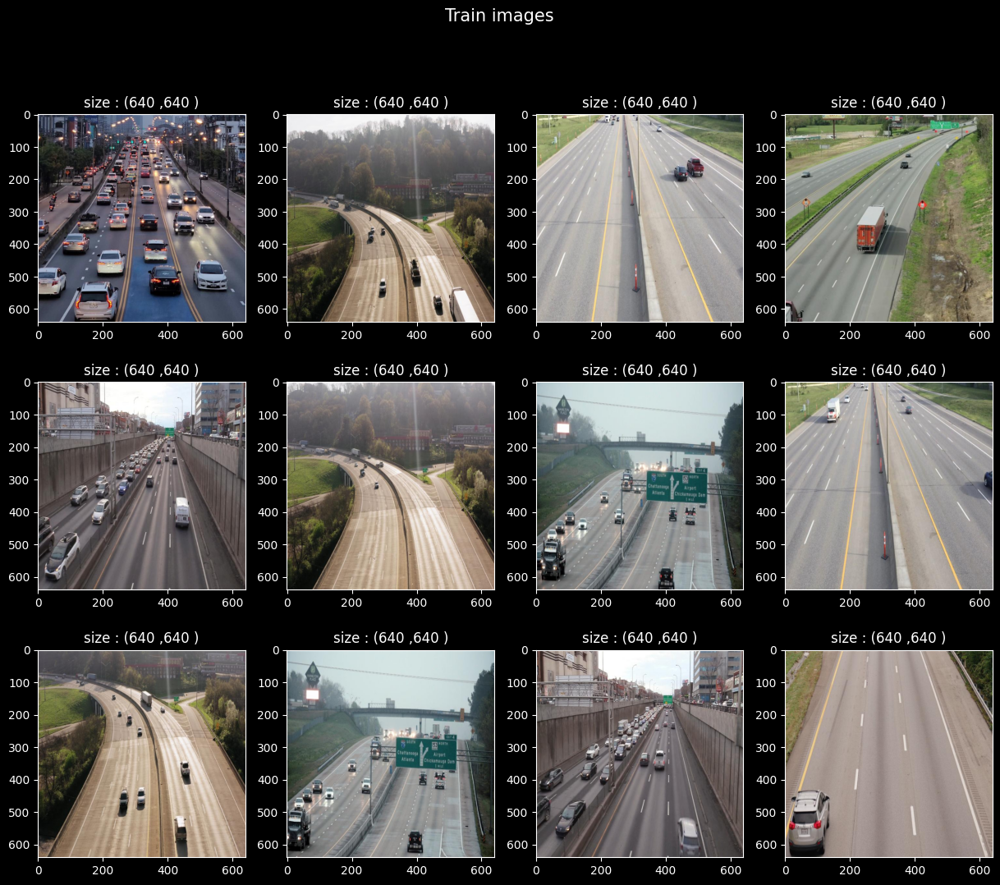

In [13]:
show_images_train(path = Train_images , num=12 , title='Train images')

In [14]:
def show_images_predicted(path , num , Model=model ,Conf=0.5 , seed=42 , title=None):
    plt.style.use('dark_background')
    random.seed(seed)
    number_image = random.choices( path,k=num)
    plt.figure(figsize=(15 , 12))
    plt.suptitle(title , fontsize=15 ,fontstyle='italic' , c='w' )
    for inx, images in enumerate(number_image):
          plt.subplot(3,4,inx+1)
          prediction = Model.predict(source=images , imgsz=640 , conf=Conf)
          predic_image = prediction[0].plot(line_width=2)
          color_channel = cv2.cvtColor(predic_image , cv2.COLOR_BGR2RGB)
          plt.imshow(color_channel)



image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/5_mp4-6_jpg.rf.04e04ecd253fee0a91865546faf4f0d0.jpg: 640x640 14 cars, 1 motorcycle, 2 trucks, 47.7ms
Speed: 7.6ms preprocess, 47.7ms inference, 433.5ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/13_mp4-15_jpg.rf.e756e6fcb5e18cee67ea86135c09ef98.jpg: 640x640 2 cars, 1 bus, 47.8ms
Speed: 2.5ms preprocess, 47.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/14_mp4-8_jpg.rf.6a5cd35540382c3fbe00632805ba7a18.jpg: 640x640 1 car, 2 trucks, 47.8ms
Speed: 1.7ms preprocess, 47.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/trai

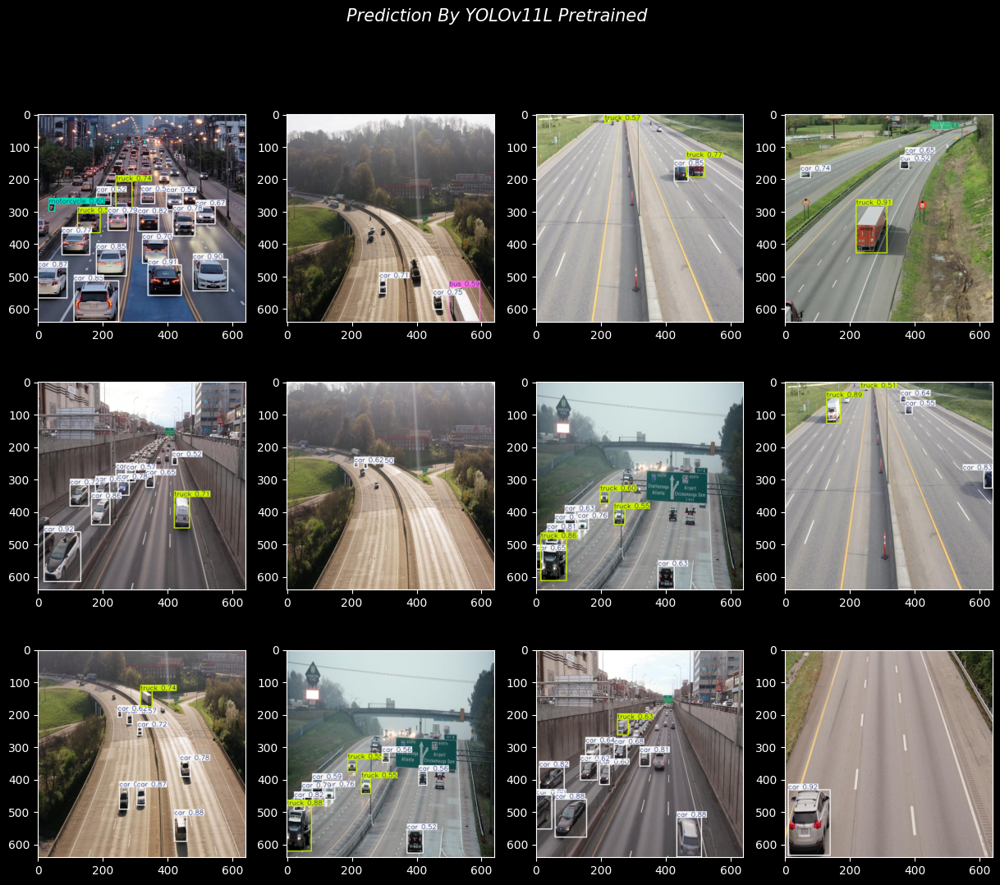

In [15]:
show_images_predicted(path=Train_images , num=12 , title='Prediction By YOLOv11L Pretrained ' )


In [16]:
def show_images(name, figsize , suptitle ):
    plt.figure(figsize=figsize )
    plt.suptitle(suptitle)
    imgs = plt.imread(name)
    plt.imshow(imgs)
    plt.axis('off')
    plt.show()
    print(f'The shape of the image is : {imgs.shape}')
    formt = name.split('.')[1]
    print(f'The format of the image is :{formt}')

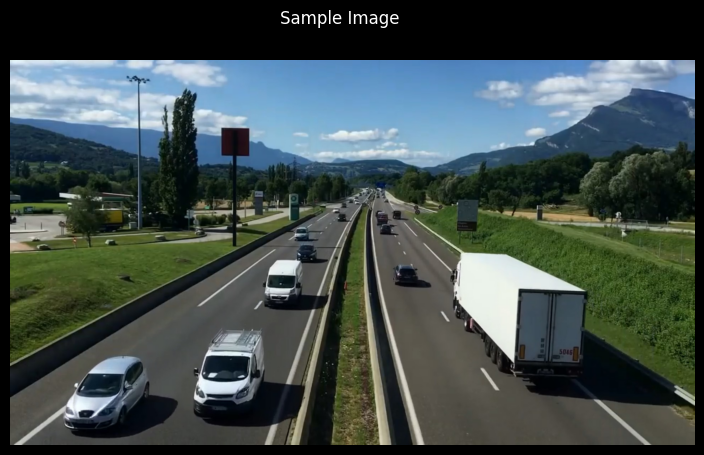

The shape of the image is : (1080, 1920, 3)
The format of the image is :jpg


In [17]:
show_images(Image_Data_Path , (10,5) , 'Sample Image')

In [18]:
Video(Video_Data_Path, embed=True, width=900)

In [19]:
yaml_File_Data_Path = '/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/data.yaml'
with open(yaml_File_Data_Path , 'r') as file :
    yaml_content = yaml.load(file , Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content , default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/images
val: ../valid/images



# YOLO Hyperparameters for Training

## Hyperparameters for YOLOv11 Training
* **data:** Path to the dataset YAML file. can define paths for tarin and validation dataset. Ex: "dta.yaml"
* **epochs:** the nuber of epochs to tarin for. common choices are 50, 100, 150, 200, and up to range 300+. Range: 10- 300+
* **imgsz:** the image size used for training. Range: 320, 416, 640, 832
* **device:** Specifies the computation device. 'cuda' for GPU-based computation and 'cpu' for CPU.
* **patience:** If no improvement is seen after a certain number of epochs, taring stpos early. common values range: 1- 50.
* **batch:** the number if images in each batch during training. it varies depending on your GPU/CPU. range: 16-128
* **optimizer:** The optimizer used for training. YOLOv11 supports different optimizer like Adam, SGD, AdamW, etc.
* **lrO:** The initial learning rate for training. Range: 0.0001 - 0.01
* **lrf:** the final learning rate after training. Range: 0.0001 - 0.01
* **dropout:** Rate for dropout regularization. helps prevent overfitting by randomly " dropping" some neurons training. Range: 0 - 0.5
* **seed:** Ste the random seed for reproducibility. range: any positive intger
* **augment:** Whether data augmenttation is applied during tarining.
* **mosaic:** Whether mosaic augmentation is enabled. this combines multiple images into one to improve robutness.
* **mixup:** image mixup augmentation that mixes two images during tarining.
* **hsv_h:** Random hue shift for augmentation. It helpes simulate different lighting conditions.
* **hsv_s:** Random saturation shift for augmentation
* **hsv_v:** Random value (brightness) shift for augmentation
* **flipud:** Vertical flipping of images.
* **fliplr:** horizontal flipping of images.
* **translate:** Amount of random translation (shifting) applied to images during augmentation
* **scale:** random scaling applied to images.
* **rotate:** Random rotation of images.
* **blur:** Whether to apply a random blurring effect to images during augmentation.

# Training Model

In [20]:
History = model.train(
    data=yaml_File_Data_Path,     
    epochs=100,              
    imgsz=640,             
    device=0,                
    patience=20,            
    batch=16,               
    optimizer='auto',        
    lr0=0.001,              
    lrf=0.01,                 
    dropout=0.1,
    augment = True ,
    mosaic=True ,
    mixup=False,      
    seed=42              
)


Ultralytics 8.3.133 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.1, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.001, lrf=0.01, mask_ratio=4, max_det=300, mixup=False, mode=train, model=yolo11l.pt, momentum=0.937, mosaic=True, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=T

100%|██████████| 755k/755k [00:00<00:00, 16.5MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 69.9MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 2.2±2.9 ms, read: 6.4±0.9 MB/s, size: 59.8 KB)


train: Scanning /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/labels... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:02<00:00, 267.77it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 1.2±0.0 ms, read: 6.6±1.4 MB/s, size: 51.4 KB)


val: Scanning /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid/labels... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<00:00, 185.24it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      10.2G      1.803       1.81      1.438        116        640: 100%|██████████| 34/34 [00:25<00:00,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.11s/it]

                   all         90        937      0.771      0.804      0.809      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      10.3G      1.195     0.8111      1.065        206        640: 100%|██████████| 34/34 [00:23<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.827      0.895      0.927      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      10.3G      1.124     0.7118      1.036        135        640: 100%|██████████| 34/34 [00:23<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         90        937      0.847      0.876      0.933      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      10.3G      1.096     0.6786       1.02         85        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.69it/s]

                   all         90        937      0.888      0.898      0.957      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      10.2G      1.082     0.6508      1.015        210        640: 100%|██████████| 34/34 [00:24<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.71it/s]

                   all         90        937      0.864       0.91      0.948      0.674



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      10.4G      1.062     0.6066      1.002         75        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.887      0.908      0.963      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      10.3G      1.043     0.5977      1.003         94        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.73it/s]

                   all         90        937       0.89      0.913      0.951      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      10.3G      1.036     0.5905      1.002        116        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.878      0.924      0.962      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      10.4G      1.024     0.5726     0.9799        161        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.876       0.93      0.957      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      10.4G      1.018      0.554     0.9883        125        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937       0.88       0.92      0.949      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      10.3G      1.011     0.5531     0.9864        113        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.898      0.904      0.968      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      10.3G      1.007     0.5474     0.9864         81        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.883       0.91      0.961        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      10.2G     0.9989     0.5545     0.9807         87        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.888      0.902      0.961      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      10.3G     0.9875     0.5277     0.9723        210        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.922      0.892      0.967       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      10.3G      1.001     0.5309     0.9842         89        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.896      0.908      0.963      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      10.3G     0.9883     0.5263     0.9814        114        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]

                   all         90        937      0.891      0.943      0.969      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      10.3G     0.9774     0.5162     0.9725        109        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.898      0.908      0.966      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      10.3G     0.9546     0.5106     0.9628        101        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.926      0.867       0.96      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      10.2G      0.948     0.4974     0.9645         73        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.908      0.922      0.969      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      10.3G     0.9532     0.4966     0.9652         92        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.891      0.928      0.972      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      10.2G     0.9402     0.4889     0.9551        179        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.878      0.932      0.957      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      10.3G     0.9321     0.4846     0.9461        126        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.904       0.93      0.964      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      10.3G     0.9457     0.5066     0.9609         81        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937        0.9      0.932      0.967      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      10.4G     0.9352     0.4855     0.9575        114        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.887      0.916      0.967      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      10.3G     0.9184     0.4862      0.951        100        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937       0.87      0.918       0.96      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      10.3G     0.9308     0.4734     0.9624        115        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.922       0.91      0.971      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      10.3G     0.9225     0.4904     0.9533         97        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.924      0.918       0.97      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      10.3G     0.9067     0.4646      0.943         79        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.913      0.927      0.972       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      10.3G     0.9177     0.4827     0.9578        125        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.938      0.879      0.964      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      10.3G     0.9191     0.5025     0.9498        170        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.899      0.917      0.956       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      10.3G     0.9121     0.4745     0.9566        129        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.914      0.919      0.964      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      10.3G     0.8956     0.4602     0.9423         78        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.922      0.925       0.97      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      10.3G     0.8825     0.4569     0.9403        111        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937       0.91      0.933      0.966      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      10.3G      0.888     0.4582     0.9427        139        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.925       0.91      0.971      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      10.3G     0.8806     0.4462     0.9363         87        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937       0.93      0.904       0.97      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      10.3G     0.9023     0.4556     0.9471         96        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.936      0.922      0.978      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      10.2G     0.8785     0.4439     0.9361        104        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.923      0.915      0.963      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      10.3G     0.8633     0.4438     0.9351        172        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         90        937      0.924      0.911      0.971       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      10.3G     0.8735     0.4324     0.9374        144        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.937      0.912      0.969       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      10.4G     0.8548     0.4351      0.932        100        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         90        937      0.932      0.916      0.973      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      10.3G     0.8778     0.4428     0.9467        105        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.905      0.927      0.966      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      10.5G     0.8637     0.4389     0.9344         77        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.918      0.903      0.967      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      10.3G      0.868     0.4417     0.9448        126        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.923      0.937      0.971      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      10.3G      0.843     0.4297     0.9301        117        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.913      0.908      0.956      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      10.3G     0.8398     0.4275     0.9265        117        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.924      0.937      0.973      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      10.4G      0.827     0.4133     0.9295        133        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.917      0.927      0.963      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      10.2G     0.8271     0.4127     0.9219        214        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.934       0.92      0.972      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      10.3G     0.8325     0.4201     0.9227        112        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.914      0.925      0.967       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      10.3G     0.8372     0.4197     0.9315         90        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937       0.91      0.915       0.96      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      10.3G     0.8373     0.4194     0.9245        116        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.915      0.938      0.961      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      10.3G     0.8189      0.411     0.9263         30        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937       0.93      0.925      0.975      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      10.4G     0.8163     0.4089     0.9195        111        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937       0.91       0.94      0.966      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      10.3G     0.8086     0.4097     0.9172        147        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.919      0.925      0.971       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      10.3G     0.8071     0.4071      0.916        193        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.916      0.917      0.971      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      10.2G      0.788     0.3939     0.9067        146        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.911      0.936      0.973      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      10.3G     0.8021     0.4038     0.9174        133        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.918      0.925      0.974      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      10.3G     0.8113     0.4044     0.9228         65        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.923      0.921      0.973      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      10.3G     0.7943     0.4001     0.9085        155        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.76it/s]

                   all         90        937       0.91       0.93      0.971      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      10.3G     0.7938     0.3924     0.9127        101        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.937      0.917      0.971      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      10.3G     0.7749     0.3888     0.9134         77        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.902      0.944      0.954      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      10.3G     0.7806     0.3908     0.9128        135        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.917       0.91      0.964      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      10.3G     0.7934     0.3943     0.9155         93        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937       0.94      0.888      0.968      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      10.2G     0.7818     0.3928     0.9152        110        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.921      0.918      0.964      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      10.4G     0.7621     0.3752     0.9033        195        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.933      0.931      0.972      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      10.2G      0.769     0.3791     0.9063         90        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937       0.92      0.932      0.961      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      10.3G     0.7578     0.3772     0.8996        125        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.927      0.935      0.966       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      10.3G     0.7525     0.3684     0.8968        122        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.77it/s]

                   all         90        937      0.904      0.943      0.965      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      10.3G       0.75      0.371     0.9039        100        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.915      0.941      0.965      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      10.3G     0.7632     0.3765     0.9081        107        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.75it/s]

                   all         90        937      0.918      0.938      0.965      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      10.3G     0.7386     0.3681     0.8973        135        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.913      0.937      0.968      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      10.2G     0.7457     0.3607     0.8981        113        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.926      0.926      0.969      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      10.3G     0.7323     0.3597     0.8934        133        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.897      0.946      0.965      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      10.3G     0.7355     0.3606     0.8938        164        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.928       0.92      0.965      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      10.3G     0.7256     0.3552     0.8966         89        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.909      0.937      0.967      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      10.3G     0.7231     0.3558      0.895        103        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.917      0.933      0.964      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      10.3G     0.7231      0.358     0.8917        102        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.916      0.928      0.953      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      10.3G     0.7142     0.3458     0.8943         83        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.926      0.933      0.959      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      10.4G     0.7147      0.349     0.8921        106        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.912      0.936      0.956      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      10.3G     0.7106     0.3485     0.8879        105        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.926      0.926      0.963      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      10.3G     0.6989     0.3469     0.8875        107        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.81it/s]

                   all         90        937      0.923      0.927      0.953      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      10.3G      0.695     0.3419     0.8873        110        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.78it/s]

                   all         90        937      0.924      0.926       0.96      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      10.3G     0.7028     0.3453      0.889         96        640: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.919      0.922      0.954      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      10.3G     0.6845     0.3414     0.8843        126        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.79it/s]

                   all         90        937      0.919      0.922      0.962      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      10.4G     0.6966     0.3387     0.8886         93        640: 100%|██████████| 34/34 [00:24<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.80it/s]

                   all         90        937      0.909      0.936      0.967      0.743
EarlyStopping: Training stopped early as no improvement observed in last 20 epochs. Best results observed at epoch 64, best model saved as best.pt.
To update EarlyStopping(patience=20) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



84 epochs completed in 0.639 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.133 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11l summary (fused): 190 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.51s/it]


                   all         90        937      0.928      0.935      0.971      0.743
Speed: 0.2ms preprocess, 34.8ms inference, 0.0ms loss, 7.9ms postprocess per image
Results saved to runs/detect/train


# Model Result

In [21]:
results_path = "/kaggle/working/runs/detect/train"

I illustarte the Accuracy metrics and Loss Metrics in a line chart to understand it better.After than I show all metrcis in a DataFrame.

In [22]:
def plot_yolo_training_results(run_folder_path , columns , title):

    csv_path = os.path.join(run_folder_path, 'results.csv')

    if not os.path.exists(csv_path):
        print(f"Error: {csv_path} does not exist.")
        return
    
    data = pd.read_csv(csv_path)
    if data.empty:
        print("Error: The results.csv file is empty.")
        return
    epochs = data.index
    plt.figure(figsize=(10, 6))

    for column in data.columns:
        if column in columns:
            plt.plot(epochs, data[column],'--',label=column  )

    plt.title(f'{title}')
    plt.xlabel("Epochs")
    plt.ylabel("Metrics")
    plt.legend()
    plt.grid(True)
    plt.show()

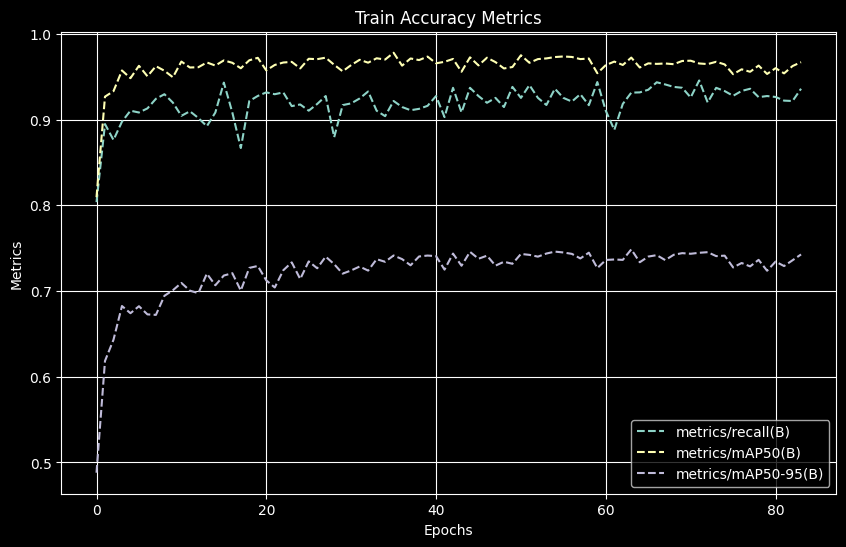

In [23]:
plot_yolo_training_results(results_path , columns=['metrics/mAP50-95(B)' ,'metrics/mAP50(B)','metrics/recall(B)' ] , title='Train Accuracy Metrics' )

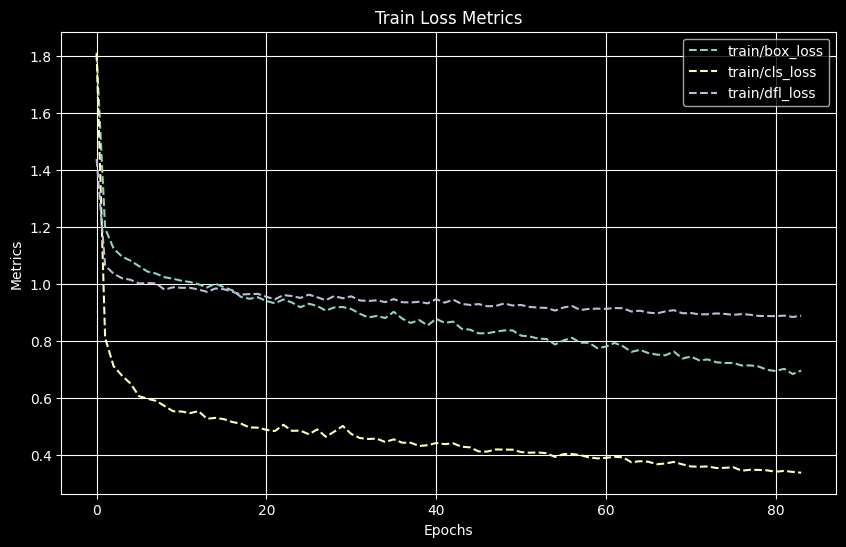

In [24]:
plot_yolo_training_results(results_path , columns=['train/box_loss' ,'train/dfl_loss' , "train/cls_loss" ] , title='Train Loss Metrics')

In [25]:
#import pandas as pd

results = '/kaggle/working/runs/detect/train/results.csv'  # update this if your path is different
results = pd.read_csv(results)
results


,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,28.4443,1.80265,1.80995,1.43753,0.77071,0.80363,0.80939,0.48799,1.36364,1.05784,1.18136,0.000647,0.000647,0.000647
1,2,55.1355,1.19463,0.81107,1.06459,0.82731,0.89472,0.92673,0.61838,1.17475,0.74769,1.10050,0.001301,0.001301,0.001301
2,3,82.3011,1.12383,0.71183,1.03578,0.84712,0.87620,0.93311,0.64311,1.10408,0.73133,1.06257,0.001941,0.001941,0.001941
3,4,110.0020,1.09557,0.67858,1.01984,0.88754,0.89755,0.95726,0.68247,1.06468,0.61660,1.04110,0.001941,0.001941,0.001941
4,5,137.8710,1.08154,0.65082,1.01451,0.86351,0.91035,0.94825,0.67409,1.03254,0.65688,1.01949,0.001921,0.001921,0.001921
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
79,80,2190.3800,0.69891,0.34691,0.88748,0.92320,0.92743,0.95319,0.72364,0.97290,0.46083,1.01161,0.000436,0.000436,0.000436
80,81,2217.5600,0.69503,0.34193,0.88729,0.92407,0.92636,0.95992,0.73428,0.96077,0.46488,1.00698,0.000416,0.000416,0.000416
81,82,2244.9400,0.70281,0.34530,0.88902,0.91852,0.92209,0.95389,0.72909,0.95876,0.45913,1.00528,0.000396,0.000396,0.000396
82,83,2272.2000,0.68449,0.34144,0.88435,0.91911,0.92164,0.96245,0.73588,0.96301,0.45576,1.00666,0.000376,0.000376,0.000376


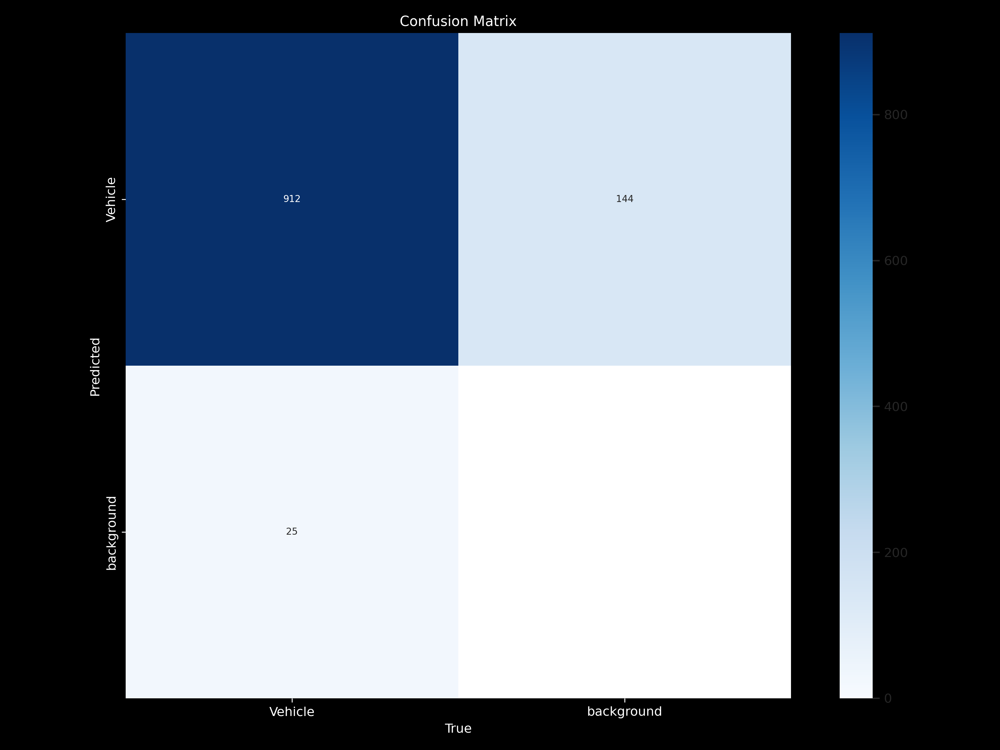

In [26]:
from IPython.display import Image, display
import os

# Path to the image
image_path = '/kaggle/working/runs/detect/train/confusion_matrix.png'

# Display the image
if os.path.exists(image_path):
    display(Image(filename=image_path))
else:
    print("Image not found:", image_path)



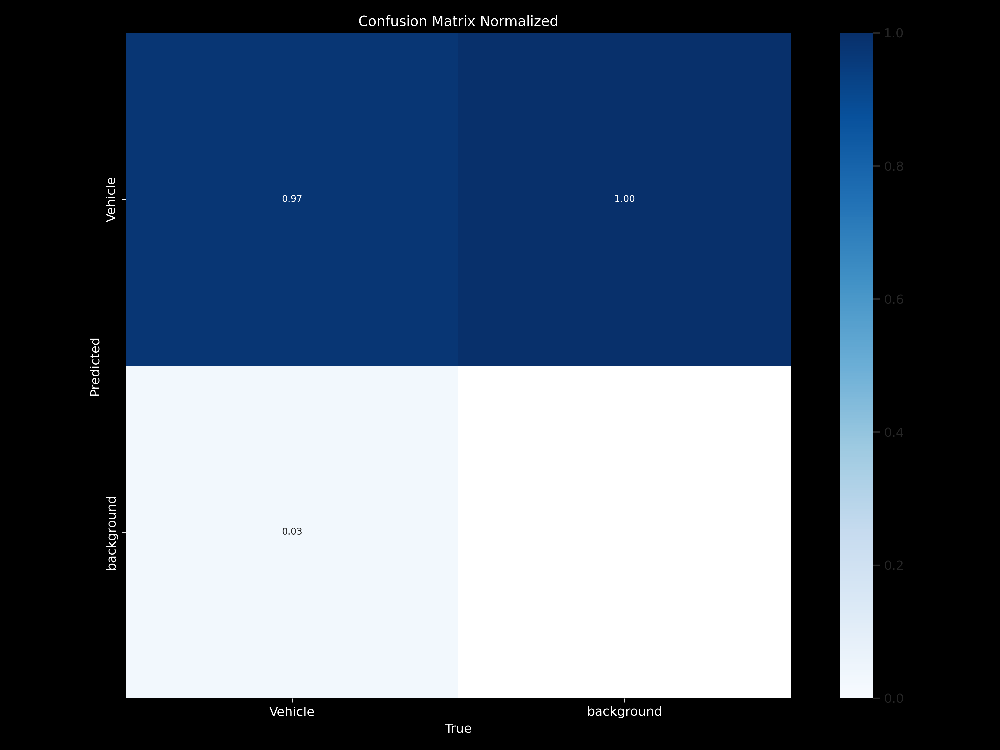

In [27]:
# Path to the image
image_path1 = '/kaggle/working/runs/detect/train/confusion_matrix_normalized.png'

# Display the image
if os.path.exists(image_path1):
    display(Image(filename=image_path1))
else:
    print("Image not found:", image_path1)


* The confusion matrix shows that the model is prefectly able to detect cars and only in some cases have False negative with bakground. Now let's see R_curve, P_curve, PR_curve and f1_curve.

In [28]:
from PIL import Image  # Correctly import PIL's Image
import matplotlib.pyplot as plt


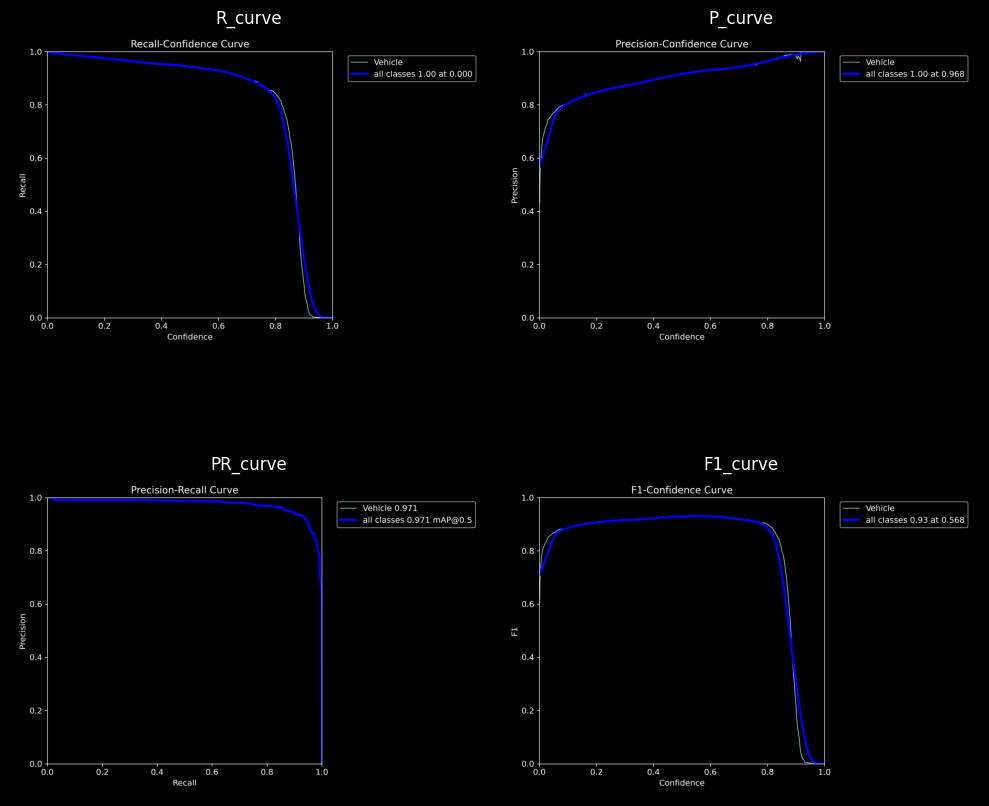

In [29]:
def show_PR_curves(*image_paths, titles=None):
    fig, axes = plt.subplots(2, 2, figsize=(10, 10))
    
    for i, ax in enumerate(axes.flatten()):
        img = Image.open(image_paths[i])  # Open image with PIL
        ax.imshow(img)
        ax.axis('off')  # Hide axis
        
        if titles and i < len(titles):
            ax.set_title(titles[i])

    plt.tight_layout()
    plt.show()
    
results_path = '/kaggle/working/runs/detect/train/'

show_PR_curves(
    results_path + 'R_curve.png',
    results_path + "P_curve.png",
    results_path + "PR_curve.png",
    results_path + "F1_curve.png",
    titles = ["R_curve", "P_curve", "PR_curve", "F1_curve"]  # Add the closing quote to "F1_curve"

)

* **P_curve:** This result indicates that when the model is very confident (92% confidence above result), it does not make Mistakes in terms of false positive.
* **R_curve:** All classes 1.00 to 0.00, indicates that the YOLO model detects all objects when no confidence threshold is applied. however, this typically leads to a lot of false positives as the model dose not filter out any detections based on its confidence level.
* The 0.92 refers to the F1 score of the model at the confidence threshold of 0.64. A 0.92 F1 score at this threshold indicates that the model is performing quite well, with a good balance of precision and recall at this specific detection confidence level.

* **PR_curve (0.971):** The model’s overall performance across all classes in terms of the precision-recall tradeoff is excellent. The higher the value, the better the model is at balancing precision and recall.

* **mAP50 (0.971):** The model achieves 97.1% average precision when considering predictions with an IoU threshold of 50%. This is a very strong result, indicating that the model is highly effective at detecting objects accurately.

# Loading The Model

In [30]:
Best_Model_Path = results_path+'/weights/best.pt'
Best_Model= YOLO(Best_Model_Path )

* From the result folder, we load the best.pt weight as our final model for prediction. There is also another weight namely last.pt which is the weight of the model based on the last epoch. We want best weight.

# Prediction of Trained Model


image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/5_mp4-6_jpg.rf.04e04ecd253fee0a91865546faf4f0d0.jpg: 640x640 23 Vehicles, 47.4ms
Speed: 1.6ms preprocess, 47.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/13_mp4-15_jpg.rf.e756e6fcb5e18cee67ea86135c09ef98.jpg: 640x640 5 Vehicles, 42.8ms
Speed: 1.4ms preprocess, 42.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/14_mp4-8_jpg.rf.6a5cd35540382c3fbe00632805ba7a18.jpg: 640x640 3 Vehicles, 32.6ms
Speed: 1.3ms preprocess, 32.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/train/images/12_mp4-31_jpg.rf.79ff

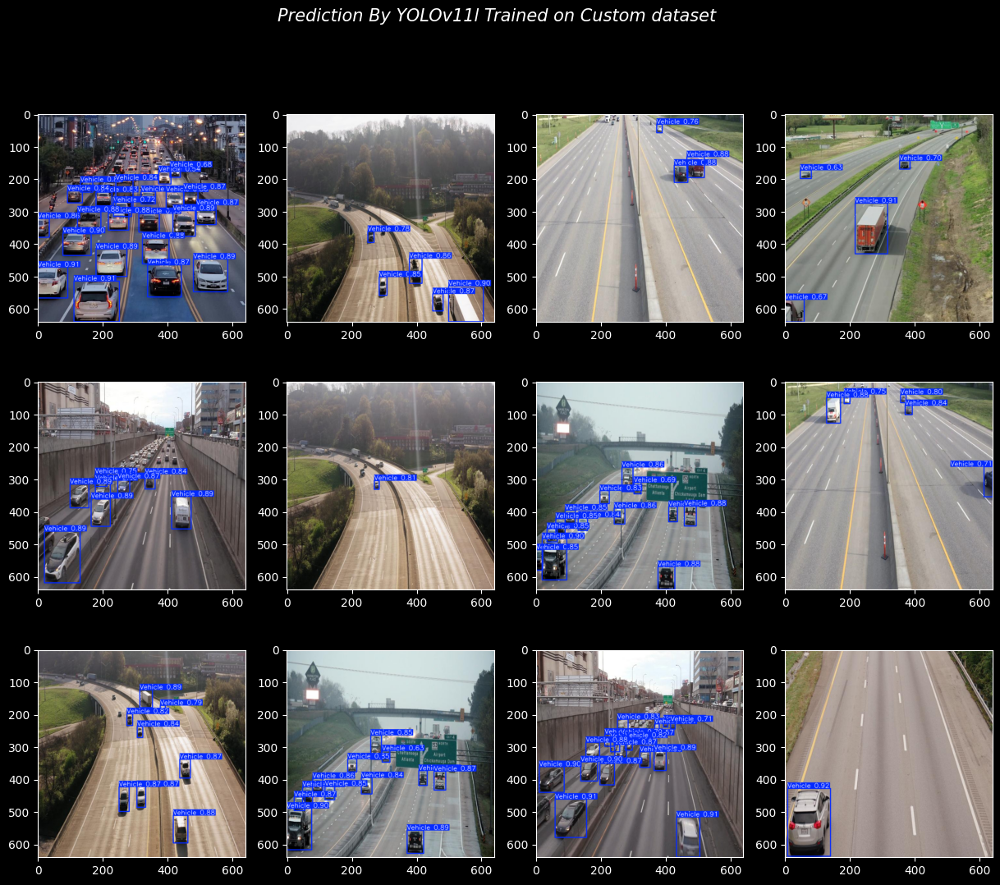

In [31]:
show_images_predicted(path=Train_images , num=12 ,Model=Best_Model ,title='Prediction By YOLOv11l Trained on Custom dataset ' )


image 1/1 /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 9 Vehicles, 49.0ms
Speed: 2.1ms preprocess, 49.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


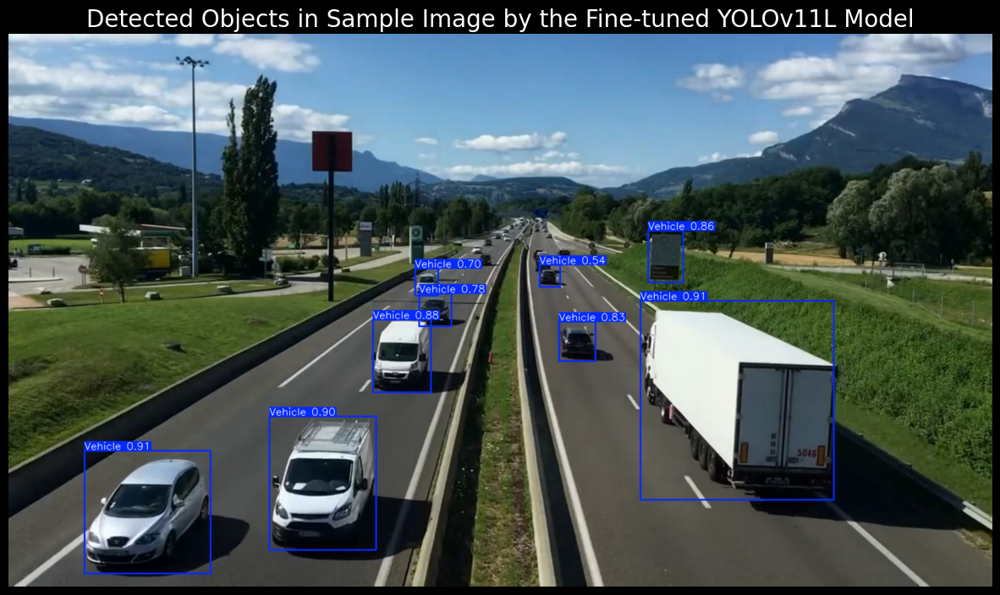

In [32]:
results = Best_Model.predict(source=Image_Data_Path, imgsz=640, conf=0.4) 
sample_image = results[0].plot(line_width=2)
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15 , 10))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv11L Model', fontsize=20)
plt.axis('off')
plt.show()

In [33]:
video_path ="/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4"
Best_Model.predict(source=video_path, save=True ,conf=0.25 )


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/601) /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4: 384x640 4 Vehicles, 30.9ms
video 1/1 (frame 2/601) /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4: 384x640 4 Vehicles, 30.9ms
video 1/1 (frame 3/601) /kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4: 384x640 4 Vehic

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Vehicle'}
 obb: None
 orig_img: array([[[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[252, 245, 242],
         [252, 245, 242],
         [252, 245, 242],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        [[254, 246, 241],
         [254, 246, 241],
         [254, 246, 241],
         ...,
         [210, 184, 166],
         [210, 184, 166],
         [210, 184, 166]],
 
        ...,
 
        [[ 94, 104, 103],
         [ 96, 106, 105],
         [101, 111, 110],
         ...,
         [ 94, 106, 111],
         [ 95, 107, 112],
         [ 97, 109, 114]],
 
        [[ 98, 108, 107],
         [103, 113, 112],
         [100, 110, 109],
         ...,
         [ 95, 10

* The result saved in the .avi format, because the YOLO saved the video based on .avi Format, i convert the video to the .mp4 and after that showed it.

In [34]:
subprocess.run(['ffmpeg', '-y', '-loglevel', 'panic', '-i', "/kaggle/working/runs/detect/predict/sample_video.avi", 'result.mp4'])

CompletedProcess(args=['ffmpeg', '-y', '-loglevel', 'panic', '-i', '/kaggle/working/runs/detect/predict/sample_video.avi', 'result.mp4'], returncode=0)

In [35]:
Video("/kaggle/working/result.mp4" , width=700 , height=500 , embed=True)


* We can see excellent performance of the model for real-time vehicle detection.Needless to say , the conf is 0.25 and if we increase the conf , it won't have some FP like the board on the right side.

In [36]:
def get_color_for_id(track_id):
    np.random.seed(track_id)  
    return tuple(np.random.randint(0, 255, size=3).tolist())

def draw_text_with_background(image, text, position, font=cv2.FONT_HERSHEY_SIMPLEX,
                              font_scale=1, font_thickness=2, text_color=(255, 255, 255), bg_color=(0, 0, 0), padding=5):

    text_size = cv2.getTextSize(text, font, font_scale, font_thickness)[0]
    text_width, text_height = text_size

    x, y = position
    top_left = (x, y - text_height - padding)
    bottom_right = (x + text_width + padding * 2, y + padding)

    cv2.rectangle(image, top_left, bottom_right, bg_color, -1)
    cv2.putText(image, text, (x + padding, y), font, font_scale, text_color, font_thickness, cv2.LINE_AA)

class YOLOVideoProcessor:
    def __init__(self, model_path, video_path, output_path, classes=[0], tracker_method="bot"):
        self.model = YOLO(model_path, task="detect")
        self.classes = classes
        self.tracker_method = tracker_method
        self.track_colors = {}  
        self.track_history = defaultdict(list)  
        self.video_path = video_path
        self.output_path = output_path 
        self.region1_active_ids = set()  
        self.region2_active_ids = set()  

    def is_in_region(self, center, poly):
        poly_np = np.array(poly, dtype=np.int32)
        return cv2.pointPolygonTest(poly_np, center, False) >= 0

    def process_video(self):
        cap = cv2.VideoCapture(self.video_path)
        prev_frame_time = 0
        all_cars = 0
        region1_cars = 0
        region2_cars = 0
        region1_status = "smooth"
        region2_status = "smooth"

        poly1 = [(465, 350), (609, 350), (520, 630), (3, 630)]
        poly2 = [(678, 350), (815, 350), (1203, 630), (743, 630)]

        frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        fourcc = cv2.VideoWriter_fourcc(*'mp4v') 
        out = cv2.VideoWriter(self.output_path, fourcc, 30, (frame_width, frame_height))  

        while cap.isOpened():
            success, frame = cap.read()
            if not success:
                break

            tracker = "botsort.yaml" if self.tracker_method.lower() == "bot" else "bytetrack.yaml"

            results = self.model.track(frame, persist=True, tracker=tracker, classes=self.classes, conf=0.25)

            if len(results[0].boxes) == 0:
                boxes = []
                track_ids = []
                confidences = []
            else:
                boxes = results[0].boxes.xywh.cpu().numpy()
                confidences = results[0].boxes.conf.cpu().numpy()  

                try:
                    track_ids = results[0].boxes.id.int().cpu().tolist()
                except AttributeError:
                    print("Tracking IDs not found.")
                    track_ids = [i for i in range(len(boxes))]  

            annotated_frame = frame.copy()
            cv2.polylines(annotated_frame, [np.array(poly1, dtype=np.int32)], isClosed=True, color=(255, 0, 0), thickness=2)
            cv2.polylines(annotated_frame, [np.array(poly2, dtype=np.int32)], isClosed=True, color=(0, 255, 0), thickness=2)

            current_region1_ids = set()
            current_region2_ids = set()
            if len(boxes) > 0 and len(track_ids) > 0:
                for box, track_id, confidence in zip(boxes, track_ids, confidences):
                    x, y, w, h = box

                    color = get_color_for_id(track_id)
                    cv2.rectangle(annotated_frame, (int(x - w / 2), int(y - h / 2)),
                                  (int(x + w / 2), int(y + h / 2)), color, 2)
                    draw_text_with_background(annotated_frame, f'ID: {track_id} ({confidence:.2f})',
                                              (int(x - w / 2), int(y - h / 2) - 10), bg_color=color)

                    center_point = (int(x), int(y))
                    cv2.circle(annotated_frame, center_point, radius=4, color=color, thickness=-1)
                    center = (float(x), float(y))
                    self.track_history[track_id].append(center)

                    if len(self.track_history[track_id]) > 15:
                        self.track_history[track_id].pop(0)

                    points = np.array(self.track_history[track_id]).astype(np.int32).reshape((-1, 1, 2))
                    cv2.polylines(annotated_frame, [points], isClosed=False, color=color, thickness=2)

                    if self.is_in_region(center_point, poly1):
                        current_region1_ids.add(track_id)

                    if self.is_in_region(center_point, poly2):
                        current_region2_ids.add(track_id)

            all_cars = len(track_ids)
            region1_cars = len(current_region1_ids)
            region2_cars = len(current_region2_ids)

            region1_status = "heavy" if region1_cars > 2 else "smooth"
            region2_status = "heavy" if region2_cars > 2 else "smooth"

            new_frame_time = time.time()
            fps = 1 / (new_frame_time - prev_frame_time)
            prev_frame_time = new_frame_time
            fps = int(fps)

            draw_text_with_background(annotated_frame, f'FPS: {fps}', (7, 30), bg_color=(0, 0, 0), text_color=(0, 255, 0))
            draw_text_with_background(annotated_frame, f'Total Cars: {all_cars}', (7, 65), bg_color=(0, 0, 0), text_color=(0, 255, 0))
            draw_text_with_background(annotated_frame, f'Left Street Cars: {region1_cars}', (7, 105), bg_color=(255, 0, 0), text_color=(255, 255, 255))

            region1_text_color = (0, 0, 255) if region1_status == "heavy" else (255, 255, 255)
            draw_text_with_background(annotated_frame, f'Road Condition: {region1_status}', 
                                      (7, 139), bg_color=(255, 0, 0), text_color=region1_text_color)

            draw_text_with_background(annotated_frame, f'Right Street Cars: {region2_cars}', (880, 105), bg_color=(0, 255, 0), text_color=(255, 255, 255))

            region2_text_color = (0, 0, 255) if region2_status == "heavy" else (255, 255, 255)
            draw_text_with_background(annotated_frame, f'Road Condition: {region2_status}', 
                                      (880, 139), bg_color=(0, 255, 0), text_color=region2_text_color)

            out.write(annotated_frame)

        cap.release()
        out.release()
        cv2.destroyAllWindows()

output_path = "path/to/save/output_video.mp4"
video_processor = YOLOVideoProcessor(
    model_path="/kaggle/working/runs/detect/train/weights/best.pt",#best.pt model that we trained already
    video_path="/kaggle/input/top-view-vehicle-detection-image-dataset/Vehicle_Detection_Image_Dataset/sample_video.mp4",# video path 
    output_path="/kaggle/working/runs/detect/predict/sample_video.avi",  #output path that we want to save the result
    tracker_method="byte", # the method of Tracker(byte or bot)
    classes=[0]# the class for prediction(only 0 we have because there is only vehicle class)
)
video_processor.process_video()

requirements: Ultralytics requirement ['lap>=0.5.12'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 28.7 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 3.9s, installed 1 package: ['lap>=0.5.12']
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


0: 384x640 4 Vehicles, 31.6ms
Speed: 1.6ms preprocess, 31.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Vehicles, 28.8ms
Speed: 1.7ms preprocess, 28.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Vehicles, 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Vehicles, 25.4ms
Speed: 1.7ms preprocess, 25.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Vehicles, 25.4ms
Speed: 1.5ms preprocess, 25.4ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 4 Vehicles, 23.2

# Result

In [37]:
subprocess.run(['ffmpeg', '-y', '-loglevel', 'panic', '-i', "/kaggle/working/runs/detect/predict/sample_video.avi", '/kaggle/working/result.mp4'])

CompletedProcess(args=['ffmpeg', '-y', '-loglevel', 'panic', '-i', '/kaggle/working/runs/detect/predict/sample_video.avi', '/kaggle/working/result.mp4'], returncode=0)

In [38]:
Video(r"/kaggle/working/result.mp4" , width=700 , height=500 , embed=True)